<a href="https://colab.research.google.com/github/xhxuciedu/CS284A/blob/master/ct_chest_segmentation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Motivation

* Automatic segmentation of medical images is an important task in medical imaging analysis.  
* It can be used for medical diagnosis, abnormality detection, or quantifications of lesions. 
* Segmentation can be carried out on relevant organs, tissues, or lesions. 
* In this notebook, we will look into methods for lung segmentation from CT scans. 


## Dataset
Make a copy to your Google drive. Later on. Later we will mount your Google drive to the colab. 
https://drive.google.com/drive/folders/1krhZD2R4QORhL_SiXNwqi1KRJ2s9zP-2


## UNet
In this notebook, we will use UNet to generate lung segmentation from images.
* Original paper: https://arxiv.org/abs/1505.04597
* An short tutorial: https://towardsdatascience.com/u-net-b229b32b4a71




## Lung segmentation
https://github.com/JoHof/lungmask

## Install some necessary libraries

In [1]:
!git clone https://github.com/mandrakedrink/ChestCTSegmentation

!pip install albumentations==0.4.6
!pip install git+https://github.com/qubvel/segmentation_models.pytorch

import sys

# Add module in system path
sys.path.append("ChestCTSegmentation")

Cloning into 'ChestCTSegmentation'...
remote: Enumerating objects: 63, done.
remote: Counting objects: 100% (63/63), done.
remote: Compressing objects: 100% (61/61), done.
remote: Total 63 (delta 18), reused 34 (delta 2), pack-reused 0
Unpacking objects: 100% (63/63), done.
     |████████████████████████████████| 122kB 6.8MB/s 
     |████████████████████████████████| 952kB 28.7MB/s 
  Created wheel for albumentations: filename=albumentations-0.4.6-cp36-none-any.whl size=65165 sha256=d5b3f5cda30d19f89661c83145bdb68568b7f383ec0be3aee739017affb89de2
  Stored in directory: /root/.cache/pip/wheels/c7/f4/89/56d1bee5c421c36c1a951eeb4adcc32fbb82f5344c086efa14
Successfully built albumentations
  Found existing installation: imgaug 0.2.9
    Uninstalling imgaug-0.2.9:
      Successfully uninstalled imgaug-0.2.9
  Found existing installation: albumentations 0.1.12
    Uninstalling albumentations-0.1.12:
      Successfully uninstalled albumentations-0.1.12
  Cloning https://github.com/qubvel/segme

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
# location of the data within google drive
homedir = '/content/drive/Shareddrives/Teaching/data/ct_chest_seg/'

In [9]:
!unzip -q '/content/drive/Shareddrives/Teaching/data/ct_chest_seg/images.zip'
!unzip -q '/content/drive/Shareddrives/Teaching/data/ct_chest_seg/masks.zip'

In [10]:
import time
import os

import torch
import numpy as np
import pandas as pd

from train import Trainer
from loss_metric import BCEDiceLoss

from segmentation_models_pytorch.unet import Unet
from IPython.display import clear_output
import warnings
warnings.simplefilter("ignore")

In [11]:
class GlobalConfig:
    def __init__(self):
        self.seed = 555
        self.path_to_csv = homedir + 'train.csv'
        self.path_to_imgs_dir = '/content/images'
        self.path_to_masks_dir = '/content/masks'
        self.pretrained_model_path = homedir+'pretrained_model/model_100_epoch.pth'
        self.train_logs_path = homedir+'pretrained_model/train_log_100_epoch.csv'


def seed_everything(seed: int):
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    np.random.seed(seed)
    
config = GlobalConfig()
seed_everything(config.seed)

In [12]:
model = Unet('efficientnet-b2', encoder_weights="imagenet", classes=3, activation=None)

Downloading: "https://github.com/lukemelas/EfficientNet-PyTorch/releases/download/1.0/efficientnet-b2-8bb594d6.pth" to /root/.cache/torch/hub/checkpoints/efficientnet-b2-8bb594d6.pth


In [13]:
# check which device the model is on
next(model.parameters()).device

device(type='cpu')

In [14]:
# set to cuda
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu") 
model = model.to(device)

# Train Process

In [15]:
trainer = Trainer(net=model,
                  criterion=BCEDiceLoss(),
                  lr=8e-5,
                  accumulation_steps=32,
                  batch_size=8,
                  num_epochs=1,
                  imgs_dir = config.path_to_imgs_dir,
                  masks_dir = config.path_to_masks_dir,
                  path_to_csv = config.path_to_csv)

if config.pretrained_model_path is not None:
    trainer.load_predtrain_model(config.pretrained_model_path)
    
    # if need - load the logs.      
    train_logs = pd.read_csv(config.train_logs_path)
    trainer.losses["train"] =  train_logs.loc[:, "train_loss"].to_list()
    trainer.losses["val"] =  train_logs.loc[:, "val_loss"].to_list()
    trainer.dice_scores["train"] = train_logs.loc[:, "train_dice"].to_list()
    trainer.dice_scores["val"] = train_logs.loc[:, "val_dice"].to_list()
    trainer.jaccard_scores["train"] = train_logs.loc[:, "train_jaccard"].to_list()
    trainer.jaccard_scores["val"] = train_logs.loc[:, "val_jaccard"].to_list()

device: cuda
Predtrain model loaded


In [ ]:
%%time
#trainer.train()

# Experiments and Results

In [16]:
from dataset_dataloader  import get_dataloader
from utils import compute_scores_per_classes

import matplotlib.pyplot as plt
import seaborn as sns

In [17]:
val_dataloader = get_dataloader(
    imgs_dir=config.path_to_imgs_dir,
    masks_dir=config.path_to_masks_dir,
    path_to_csv=config.path_to_csv,
    phase = "val",
    batch_size = 8,
    num_workers = 6,
    test_size = 0.2,
)

## Visualize the data

In [23]:
import matplotlib.pyplot as plt

In [24]:
img,mask = iter(val_dataloader).next()

In [25]:
img.shape, mask.shape

(torch.Size([8, 3, 512, 512]), torch.Size([8, 3, 512, 512]))

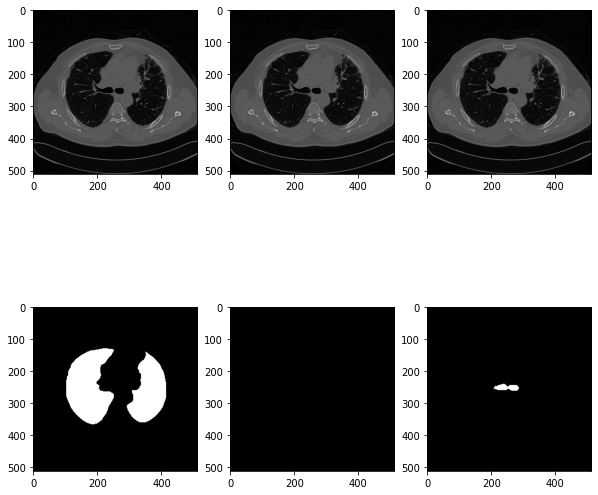

In [38]:
fig,ax = plt.subplots(2,3,figsize=(10,10))
ax[0,0].imshow(img[0,0],cmap='gray')
ax[0,1].imshow(img[0,1],cmap='gray')
ax[0,2].imshow(img[0,2],cmap='gray')
ax[1,0].imshow(mask[0,0],cmap='gray')
ax[1,1].imshow(mask[0,1],cmap='gray')
ax[1,2].imshow(mask[0,2],cmap='gray')

In [39]:
%%time
dice_scores_per_classes, iou_scores_per_classes = compute_scores_per_classes(
    model, val_dataloader, ['lung', 'heart', 'trachea']
    )

CPU times: user 1min 52s, sys: 43.4 s, total: 2min 35s
Wall time: 2min 29s


In [40]:
dice_df = pd.DataFrame(dice_scores_per_classes)
dice_df.columns = ['lung dice', 'heart dice', 'trachea dice']

iou_df = pd.DataFrame(iou_scores_per_classes)
iou_df.columns = ['lung jaccard', 'heart jaccard', 'trachea jaccard']
val_metics_df = pd.concat([dice_df, iou_df], axis=1, sort=True)
val_metics_df = val_metics_df.loc[:, ['lung dice', 'lung jaccard', 
                                      'heart dice', 'heart jaccard', 
                                      'trachea dice', 'trachea jaccard']]
val_metics_df

,lung dice,lung jaccard,heart dice,heart jaccard,trachea dice,trachea jaccard
0,0.984511,0.969495,0.938485,0.884099,1.000000,1.000000
1,0.986940,0.974217,1.000000,1.000000,1.000000,1.000000
2,0.992211,0.984542,1.000000,1.000000,0.973717,0.948780
3,0.995396,0.990834,1.000000,1.000000,1.000000,1.000000
4,0.690909,0.527778,1.000000,1.000000,0.952183,0.908730
...,...,...,...,...,...,...
3337,0.996470,0.992966,1.000000,1.000000,0.990617,0.981409
3338,0.590164,0.418605,1.000000,1.000000,1.000000,1.000000
3339,0.920455,0.852632,1.000000,1.000000,1.000000,1.000000
3340,0.991316,0.982781,1.000000,1.000000,0.914373,0.842254


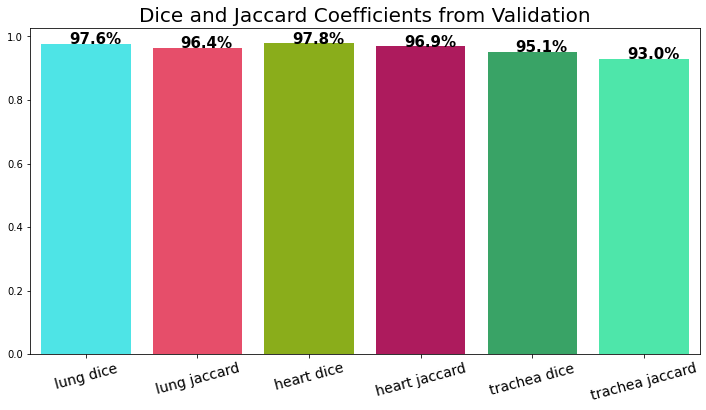

In [41]:
colors = ['#35FCFF', '#FF355A', '#96C503', '#C5035B', '#28B463', '#35FFAF']
palette = sns.color_palette(colors, 6)

fig, ax = plt.subplots(figsize=(12, 6));
sns.barplot(x=val_metics_df.mean().index, y=val_metics_df.mean(), palette=palette, ax=ax);
ax.set_xticklabels(val_metics_df.columns, fontsize=14, rotation=15);
ax.set_title("Dice and Jaccard Coefficients from Validation", fontsize=20)

for idx, p in enumerate(ax.patches):
        percentage = '{:.1f}%'.format(100 * val_metics_df.mean().values[idx])
        x = p.get_x() + p.get_width() / 2 - 0.15
        y = p.get_y() + p.get_height()
        ax.annotate(percentage, (x, y), fontsize=15, fontweight="bold")

fig.savefig("result1.png", format="png",  pad_inches=0.2, transparent=False, bbox_inches='tight')
fig.savefig("result1.svg", format="svg",  pad_inches=0.2, transparent=False, bbox_inches='tight')

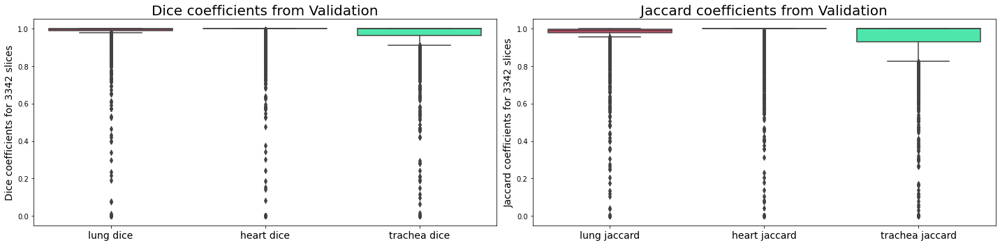

In [42]:
colors = ['#35FCFF', '#FF355A', '#28B463', '#35FFAF', '#96C503', '#C5035B']
palette = sns.color_palette(colors[1::], 3)

fig, ax = plt.subplots(1, 2, figsize=(20, 5))
sns.boxplot(data=dice_df, palette=palette, ax=ax[0])
ax[0].set_ylabel("Dice coefficients for 3342 slices", fontsize=14)
ax[0].set_title("Dice coefficients from Validation", fontsize=20)
ax[0].set_xticklabels(dice_df.columns, fontsize=14)

sns.boxplot(data=iou_df, palette=palette, ax=ax[1])
ax[1].set_ylabel("Jaccard coefficients for 3342 slices", fontsize=14)
ax[1].set_title("Jaccard coefficients from Validation", fontsize=20)
ax[1].set_xticklabels(iou_df.columns, fontsize=14)
plt.tight_layout()

fig.savefig("result2.png", format="png",  pad_inches=0.2, transparent=False, bbox_inches='tight')
fig.savefig("result2.svg", format="svg",  pad_inches=0.2, transparent=False, bbox_inches='tight')

and train history logs 

In [43]:
train_logs = pd.read_csv(config.train_logs_path)
train_logs.head(5)

,train_loss,val_loss,train_dice,val_dice,train_jaccard,val_jaccard
0,0.386394,0.176678,0.697667,0.755589,0.646303,0.717975
1,0.144522,0.123104,0.769935,0.786307,0.731782,0.752826
2,0.112448,0.093943,0.811846,0.829476,0.775296,0.795960
3,0.087972,0.073344,0.838840,0.851835,0.804823,0.819167
4,0.073297,0.064866,0.854065,0.861600,0.821115,0.830928


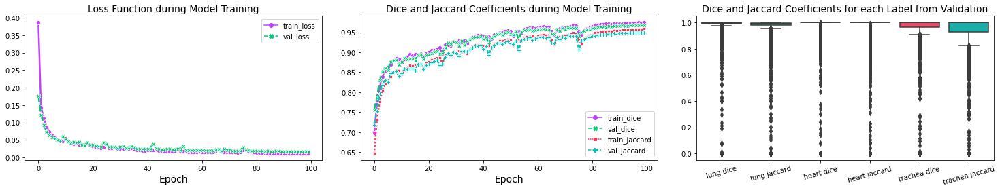

In [44]:
colors = ['#C042FF', '#03C576FF', '#FF355A', '#03C5BF', '#96C503', '#C5035B']
palettes = [sns.color_palette(colors, 2),
            sns.color_palette(colors, 4), 
            sns.color_palette(colors[:2]+colors[-2:] + colors[2:-2], 6)]
            
fig, ax = plt.subplots(1, 3, figsize=(21, 4))

sns.lineplot(data=train_logs.iloc[:, :2], palette=palettes[0], markers=True, ax=ax[0], linewidth=2.5,)
ax[0].set_title("Loss Function during Model Training", fontsize=14)
ax[0].set_xlabel("Epoch", fontsize=14)

sns.lineplot(data=train_logs.iloc[:, 2:], palette=palettes[1], markers=True, ax=ax[1], linewidth=2.5, legend="full")
ax[1].set_title("Dice and Jaccard Coefficients during Model Training", fontsize=14)
ax[1].set_xlabel("Epoch", fontsize=14)

sns.boxplot(data=val_metics_df.iloc[:,:], palette=palettes[2], ax=ax[2])
ax[2].set_title("Dice and Jaccard Coefficients for each Label from Validation", fontsize=14)
ax[2].set_xticklabels(val_metics_df.columns, fontsize=10, rotation=15)

plt.tight_layout()
fig.savefig("result3.png", format="png",  pad_inches=0.2, transparent=False, bbox_inches='tight')
fig.savefig("result3.svg", format="svg",  pad_inches=0.2, transparent=False, bbox_inches='tight')

Now let's make a video with overlapped masks for each slice of one id CT 

In [45]:
from utils import (get_one_slice_data, 
                   get_id_predictions, 
                   get_overlaid_masks_on_image,
                   get_overlaid_masks_on_full_ctscan,
                   create_video)
from visualizer import show_video

In [46]:
df = pd.read_csv(config.path_to_csv)
df["Id"] = df['ImageId'].apply(lambda x: x.split("_")[0])

id_ = 'ID00400637202305055099402'
full_scan_example = df.loc[df['Id'] == id_].reset_index(drop=True)
full_scan_example 

,ImageId,MaskId,Id
0,ID00400637202305055099402_0.jpg,ID00400637202305055099402_mask_0.jpg,ID00400637202305055099402
1,ID00400637202305055099402_1.jpg,ID00400637202305055099402_mask_1.jpg,ID00400637202305055099402
2,ID00400637202305055099402_2.jpg,ID00400637202305055099402_mask_2.jpg,ID00400637202305055099402
3,ID00400637202305055099402_3.jpg,ID00400637202305055099402_mask_3.jpg,ID00400637202305055099402
4,ID00400637202305055099402_4.jpg,ID00400637202305055099402_mask_4.jpg,ID00400637202305055099402
...,...,...,...
260,ID00400637202305055099402_260.jpg,ID00400637202305055099402_mask_260.jpg,ID00400637202305055099402
261,ID00400637202305055099402_261.jpg,ID00400637202305055099402_mask_261.jpg,ID00400637202305055099402
262,ID00400637202305055099402_262.jpg,ID00400637202305055099402_mask_262.jpg,ID00400637202305055099402
263,ID00400637202305055099402_263.jpg,ID00400637202305055099402_mask_263.jpg,ID00400637202305055099402


### Ground Truth

In [47]:
PATH_TO_SAVE = id_ + "_ground_truth"

if not os.path.exists(PATH_TO_SAVE):
    os.mkdir(PATH_TO_SAVE)
    print(f"Folder {PATH_TO_SAVE} created.")

get_overlaid_masks_on_full_ctscan(ct_scan_id_df=full_scan_example,
                                  path_to_save=PATH_TO_SAVE)

Folder ID00400637202305055099402_ground_truth created.


In [48]:
%%time
create_video(path_to_imgs=PATH_TO_SAVE, video_name=id_+"_ground_truth", framerate=30)

CPU times: user 2.64 s, sys: 46.7 ms, total: 2.68 s
Wall time: 2.88 s


In [49]:
# to play in google colab had to recode
#https://ottverse.com/ffmpeg-drawtext-filter-dynamic-overlays-timecode-scrolling-text-credits/
!ffmpeg -i 'ID00400637202305055099402_ground_truth.mp4' -vf "drawtext=text='Ground Truth':x=195:y=8:fontsize=24:fontcolor='#FFFFFF'" -strict -2 'transcoded_video1.mp4'

ffmpeg version 3.4.8-0ubuntu0.2 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.2 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-lib

In [50]:
show_video("transcoded_video1.mp4")

### Prediction

In [51]:
imgs, predictions = get_id_predictions(net=model,
                                       ct_scan_id_df=full_scan_example,
                                       root_imgs_dir=config.path_to_imgs_dir)

device: cuda


In [52]:
%%time
PATH_TO_SAVE = id_ + "_predictions"

if not os.path.exists(PATH_TO_SAVE):
    os.mkdir(PATH_TO_SAVE)
    print(f"Folder {PATH_TO_SAVE} created.")

_= [
    get_overlaid_masks_on_image(one_slice_image=image,
                                one_slice_mask=mask, 
                                write=True,
                                path_to_save=PATH_TO_SAVE,
                                name_to_save= str(i_name)
                                ) 
    for i_name, (image, mask) in enumerate(zip(imgs, predictions))
    ]

Folder ID00400637202305055099402_predictions created.
CPU times: user 1min 15s, sys: 766 ms, total: 1min 15s
Wall time: 1min 15s


In [53]:
%%time
create_video(path_to_imgs=PATH_TO_SAVE, video_name=id_+"_predictions", framerate=30)

CPU times: user 2.67 s, sys: 50.7 ms, total: 2.72 s
Wall time: 2.72 s


In [54]:
!ffmpeg -i 'ID00400637202305055099402_predictions.mp4' -vf "drawtext=text='Prediction':x=195:y=8:fontsize=24:fontcolor='#FFFFFF'" -strict -2 'transcoded_video2.mp4'

ffmpeg version 3.4.8-0ubuntu0.2 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.2 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-lib

In [55]:
show_video("transcoded_video2.mp4")

Merging video with ground truth slices and video with predicted slices

In [56]:
%%shell
#  https://unix.stackexchange.com/questions/233832/merge-two-video-clips-into-one-placing-them-next-to-each-other
ffmpeg \
  -i transcoded_video1.mp4 \
  -i transcoded_video2.mp4 \
  -filter_complex '[0:v]pad=iw*2:ih[int];[int][1:v]overlay=W/2:0[vid]' \
  -map [vid] \
  -c:v libx264 \
  -crf 23 \
  -preset veryfast \
  result.mp4

ffmpeg version 3.4.8-0ubuntu0.2 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.2 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-lib

In [57]:
show_video("result.mp4")